# Store Sales

In [245]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import plotly.express as px

from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.tsa.deterministic import CalendarFourier, DeterministicProcess

from sklearn.linear_model import Ridge
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.metrics import mean_squared_log_error
from sklearn.model_selection import train_test_split

import warnings

PATH = 'data/'

warnings.filterwarnings("ignore")

## EDA - Data Analysis
- 데이터 및 문제 이해 단계
- 각 데이터를 개별적으로 분석
- 54개의 매장과 33개의 제품군에 대해 개별적으로 모델을 학습시키고자 한다.

In [246]:
train = pd.read_csv(PATH + 'train.csv', dtype={'store_nbr': 'category'}, 
                    usecols=['store_nbr', 'family', 'date', 'sales', 'onpromotion'])
test = pd.read_csv(PATH + 'test.csv', dtype={'store_nbr': 'category'},
                   usecols=['store_nbr', 'family', 'date', 'onpromotion'])

# Check for missing values
print('Missing values in train:', train.isna().sum().sum())
print('Missing values in test:', test.isna().sum().sum())

# There are some missing dates in training set ['2013-12-25', '2014-12-25', '2015-12-25', '2016-12-25'] 

train['date'] = pd.to_datetime(train['date'])
test['date'] = pd.to_datetime(test['date'])

Missing values in train: 0
Missing values in test: 0


In [247]:
train["sales"].value_counts(), train["onpromotion"].value_counts()

(0.000       939130
 1.000       115291
 2.000        85959
 3.000        68575
 4.000        57846
              ...  
 116.541          1
 363.533          1
 141.322          1
 409.879          1
 2419.729         1
 Name: sales, Length: 379610, dtype: int64,
 0      2389559
 1       174551
 2        79386
 3        45862
 4        31659
         ...   
 313          1
 452          1
 642          1
 305          1
 425          1
 Name: onpromotion, Length: 362, dtype: int64)

- 값에 0 이 많다는 것은 의심을 가질만 한 부분이다.
    + 매장이 정상적이지 않아서 0 으로 넣었을 수 있다.
    + 정보가 없어서 0 으로 넣었을 가능성도 있다.

In [248]:
temp = train.set_index('date').groupby('store_nbr').resample('D').sales.sum().reset_index()
px.line(temp, x='date', y='sales', color='store_nbr',
        title='Daily total sales of the stores')

- 시각화를 통해서 보았을 때 몇개의 매장은 과거 장기간 매출이 0 으로 되어있다.
    + 이는 매장이 운영전일 가능성을 염두해두고 지운다.

In [249]:
print(train.shape)
train = train[~((train.store_nbr == '52') & (train.date < "2017-04-20"))]
train = train[~((train.store_nbr == '22') & (train.date < "2015-10-09"))]
train = train[~((train.store_nbr == '42') & (train.date < "2015-08-21"))]
train = train[~((train.store_nbr == '21') & (train.date < "2015-07-24"))]
train = train[~((train.store_nbr == '29') & (train.date < "2015-03-20"))]
train = train[~((train.store_nbr == '20') & (train.date < "2015-02-13"))]
train = train[~((train.store_nbr == '53') & (train.date < "2014-05-29"))]
train = train[~((train.store_nbr == '36') & (train.date < "2013-05-09"))]
print(train.shape)

(3000888, 5)
(2780316, 5)


In [250]:
temp = train.set_index('date').groupby('store_nbr').resample('D').sales.sum().reset_index()
px.line(temp, x='date', y='sales', color='store_nbr',
        title='Daily total sales of the stores')

- "onpromotion" 은 프로모션이 진행중인 제품군의 총 품목 수에 대한 정보이다.
    + 매출에 충분히 영향을 줄 수 있는 정보라고 판단한다.

In [251]:
train.corr('spearman').sales.loc['onpromotion']

0.5328877286580788

- 위의 상관관계는 의미가 없다고 배제하기는 힘들다.

In [252]:
transactions = pd.read_csv(PATH + 'transactions.csv', dtype={'store_nbr': 'category'})

print('Missing values in transactions:', train.isna().sum().sum())

# Similar to training set, we have missing dates ['2013-12-25', '2014-12-25', '2015-12-25', 
#                                                 '2016-01-01', '2016-01-03', '2016-12-25']

transactions['date'] = pd.to_datetime(transactions['date'])

Missing values in transactions: 0


In [253]:
# Proof that transactions are highly correlated with sales
temp = pd.merge(train.groupby(['date', 'store_nbr']).sales.sum().reset_index(),
                transactions, how='left')
print(temp.corr("spearman").sales.loc["transactions"])

px.scatter(temp, x="transactions", y="sales", trendline="ols", trendline_color_override="red")

0.8174644354591597


- Train data 의 sales 정보와 Transactions data 의 transactions 정보가 상관관계를 띄고 있음을 볼 수 있다.

In [254]:
px.line(transactions.sort_values(["store_nbr", "date"]), x="date", y="transactions", color="store_nbr", title="Transactions")

In [255]:
# Now we can proof that stores on holidays make more money than on working days
temp = transactions.copy()
temp['year'] = temp.date.dt.year
temp['day_of_week'] = temp.date.dt.dayofweek + 1
temp = temp.groupby(['year', 'day_of_week']).transactions.mean().reset_index()

px.line(temp, x='day_of_week', y='transactions', color='year', title='Transactions')

- 그렇다면 Transactions 데이터의 transactions 패턴은 sales 와 연관이 있을 것으로 추정하고 transactions 패턴을 보았다.
    + 그때 transactions 의 패턴은 연말에 거래량이 높아짐을 볼 수 있다
    + 주말에 거래량이 높아짐을 볼 수 있다.
- 이를 통해 우리는 Holiday 데이터에 집중해야한다는 판단을 내릴 수 있다.

In [256]:
def strip_spaces(a_str_with_spaces):
    return a_str_with_spaces.replace(' ', '')

holidays = pd.read_csv(PATH + 'holidays_events.csv', index_col='date',
                       parse_dates=['date'], infer_datetime_format=True,
                       converters={'locale_name': strip_spaces})

print('Holidays types:', holidays['type'].unique())
print('Holidays region types:', holidays['locale'].unique()) 
print('Holidays locale names:', holidays['locale_name'].unique())
print('Missing values in holidays ', holidays.isna().sum().sum())

Holidays types: ['Holiday' 'Transfer' 'Additional' 'Bridge' 'Work Day' 'Event']
Holidays region types: ['Local' 'Regional' 'National']
Holidays locale names: ['Manta' 'Cotopaxi' 'Cuenca' 'Libertad' 'Riobamba' 'Puyo' 'Guaranda'
 'Imbabura' 'Latacunga' 'Machala' 'SantoDomingo' 'ElCarmen' 'Cayambe'
 'Esmeraldas' 'Ecuador' 'Ambato' 'Ibarra' 'Quevedo'
 'SantoDomingodelosTsachilas' 'SantaElena' 'Quito' 'Loja' 'Salinas'
 'Guayaquil']
Missing values in holidays  0


- Holidays 데이터에 대한 이해 이후, 근무일과 근무일이 아닌 날로 나누려고 한다.

In [257]:
# Calendar
holidays_rdy = pd.DataFrame(index=pd.date_range('2013-01-01', '2017-08-31'))
holidays_rdy['day_of_week'] = holidays_rdy.index.dayofweek + 1  # Monday = 1, Sunday = 7
holidays_rdy['work_day'] = True
holidays_rdy.loc[holidays_rdy['day_of_week'] > 5, 'work_day'] = False  # False for saturdays and sundays 

# Fixing index duplicates in holidays dataset
duplicates = holidays[holidays.index.duplicated(keep=False)]
print(duplicates['locale_name'])

# This was done manually
duplicates = [('2012-06-25', 'Latacunga Machala'), ('2012-07-03', 'ElCarmen'),
              ('2012-12-22', 'Ecuador'), ('2012-12-24', 'Ecuador'),
              ('2012-12-31', 'Ecuador'), ('2013-05-12', 'Ecuador'),
              ('2013-06-25', 'Machala Latacunga'), ('2013-07-03', 'SantoDomingo'),
              ('2013-12-22', 'Salinas'), ('2014-06-25', 'Machala Imbabura Ecuador'),
              ('2014-07-03', 'SantoDomingo'), ('2014-12-22', 'Ecuador'),
              ('2014-12-26', 'Ecuador'), ('2015-06-25', 'Imbabura Latacunga'),
              ('2015-07-03', 'SantoDomingo'), ('2015-12-22', 'Salinas'),
              ('2016-04-21', 'Ecuador'), ('2016-05-01', 'Ecuador'),
              ('2016-05-07', 'Ecuador'), ('2016-05-08', 'Ecuador'),
              ('2016-05-12', 'Ecuador'), ('2016-06-25', 'Imbabura Latacunga'),
              ('2016-07-03', 'SantoDomingo'), ('2016-07-24', 'Guayaquil'),
              ('2016-11-12', 'Ecuador'), ('2016-12-22', 'Salinas'),
              ('2017-04-14', 'Ecuador'), ('2017-06-25', 'Latacunga Machala'),
              ('2017-07-03', 'SantoDomingo'), ('2017-12-08', 'Quito'),
              ('2017-12-22', 'Ecuador')]
# No holidays was transferred in duplicates

holidays = holidays.groupby(holidays.index).first() # we left only first, but we need others too
for date, locale_name in duplicates:
    holidays.loc[date, 'locale_name'] = holidays.loc[date, 'locale_name'] + ' ' + locale_name

date
2012-06-25        Imbabura
2012-06-25       Latacunga
2012-06-25         Machala
2012-07-03    SantoDomingo
2012-07-03        ElCarmen
                  ...     
2017-07-03    SantoDomingo
2017-12-08            Loja
2017-12-08           Quito
2017-12-22         Salinas
2017-12-22         Ecuador
Name: locale_name, Length: 69, dtype: object


In [258]:
# Apply holidays to calendar
holidays_rdy = holidays_rdy.merge(holidays, how='left', left_index=True, right_index=True)

# type column: 'Work Day'
holidays_rdy.loc[holidays_rdy['type'] == 'Work Day', 'work_day'] = True

# type column: 'Holiday', 'Transfer', 'Additional', 'Bridge'
holidays_rdy.loc[(holidays_rdy['type'] == 'Holiday') &
                 (holidays_rdy['locale_name'].str.contains('Ecuador', na=False)),
                 'work_day'] = False
holidays_rdy.loc[(holidays_rdy['type'] == 'Transfer') & 
                 (holidays_rdy['locale_name'].str.contains('Ecuador', na=False)),  
                 'work_day'] = False
holidays_rdy.loc[(holidays_rdy['type'] == 'Additional') & 
                 (holidays_rdy['locale_name'].str.contains('Ecuador', na=False)),
                 'work_day'] = False
holidays_rdy.loc[(holidays_rdy['type'] == 'Bridge') & 
                 (holidays_rdy['locale_name'].str.contains('Ecuador', na=False)),   
                 'work_day'] = False

holidays_rdy.drop(['locale'], axis=1, inplace=True)

# transferred column
holidays_rdy.loc[holidays_rdy['transferred'] == True, 'work_day'] = True
holidays_rdy

,day_of_week,work_day,type,locale_name,description,transferred
2013-01-01,2,False,Holiday,Ecuador,Primer dia del ano,False
2013-01-02,3,True,NaN,NaN,NaN,NaN
2013-01-03,4,True,NaN,NaN,NaN,NaN
2013-01-04,5,True,NaN,NaN,NaN,NaN
2013-01-05,6,True,Work Day,Ecuador,Recupero puente Navidad,False
...,...,...,...,...,...,...
2017-08-27,7,False,NaN,NaN,NaN,NaN
2017-08-28,1,True,NaN,NaN,NaN,NaN
2017-08-29,2,True,NaN,NaN,NaN,NaN
2017-08-30,3,True,NaN,NaN,NaN,NaN


- type 컬럼 중 Event 정보에 주의할 필요가 있다.
    + 이 정보를 보기 편하게 전처리 하겠다.

In [259]:
events = holidays_rdy[holidays_rdy['type']=='Event']
events

,day_of_week,work_day,type,locale_name,description,transferred
2014-05-11,7,False,Event,Ecuador,Dia de la Madre,False
2014-06-12,4,True,Event,Ecuador,Inauguracion Mundial de futbol Brasil,False
2014-06-15,7,False,Event,Ecuador,Mundial de futbol Brasil: Ecuador-Suiza,False
2014-06-20,5,True,Event,Ecuador,Mundial de futbol Brasil: Ecuador-Honduras,False
2014-06-28,6,False,Event,Ecuador,Mundial de futbol Brasil: Octavos de Final,False
2014-06-29,7,False,Event,Ecuador,Mundial de futbol Brasil: Octavos de Final,False
2014-06-30,1,True,Event,Ecuador,Mundial de futbol Brasil: Octavos de Final,False
2014-07-01,2,True,Event,Ecuador,Mundial de futbol Brasil: Octavos de Final,False
2014-07-04,5,True,Event,Ecuador,Mundial de futbol Brasil: Cuartos de Final,False
2014-07-05,6,False,Event,Ecuador,Mundial de futbol Brasil: Cuartos de Final,False


In [260]:
# I do it for simplicity
holidays_rdy.loc[holidays_rdy['description'].str.contains('Terremoto', na=False), 'description'] = 'Earthquake'
holidays_rdy.loc[holidays_rdy['description'].str.contains('futbol', na=False), 'description'] = 'Football'
events = holidays_rdy[holidays_rdy['type']=='Event']
events

,day_of_week,work_day,type,locale_name,description,transferred
2014-05-11,7,False,Event,Ecuador,Dia de la Madre,False
2014-06-12,4,True,Event,Ecuador,Football,False
2014-06-15,7,False,Event,Ecuador,Football,False
2014-06-20,5,True,Event,Ecuador,Football,False
2014-06-28,6,False,Event,Ecuador,Football,False
2014-06-29,7,False,Event,Ecuador,Football,False
2014-06-30,1,True,Event,Ecuador,Football,False
2014-07-01,2,True,Event,Ecuador,Football,False
2014-07-04,5,True,Event,Ecuador,Football,False
2014-07-05,6,False,Event,Ecuador,Football,False


In [261]:
# Check for misspells
print(events['description'].unique())

# Print mean sales 
sales = train.groupby(['date']).sales.sum()
events = events.merge(sales, how='left', left_index=True, right_index=True)
print(events.groupby(['description']).sales.mean())
print('All sales mean:', sales.mean())

['Dia de la Madre' 'Football' 'Black Friday' 'Cyber Monday' 'Earthquake']
description
Black Friday       647508.781658
Cyber Monday       777344.484674
Dia de la Madre    632258.371941
Earthquake         866433.436092
Football           569432.001918
Name: sales, dtype: float64
All sales mean: 637556.3849186868


- Event 를 5가지 유형으로 정리 했을때 어떤 Event가 매출에 영향을 줄까 생각해보았다.
    + 다른 정보는 잘 몰라도 'Black Friday', 'Cyber Monday', 'Earthquake'에는 매출이 평균보다 높음을 볼 수 있다.

In [262]:
# descriptions 
descriptions = pd.get_dummies(holidays_rdy['description'])[['Earthquake', 'Cyber Monday', 'Black Friday']]
holidays_rdy = holidays_rdy.merge(descriptions, how='left', left_index=True, right_index=True)

# Fill NaNs
holidays_rdy['locale_name'].fillna('Ecuador', inplace=True)

# Get rid of useless columns
holidays_rdy.drop(['type', 'description', 'transferred'], axis=1, inplace=True)

# If you want to merge two dataframes, they should have same indexes, later we will need it
holidays_rdy['date'] = holidays_rdy.index
holidays_rdy['date'] = pd.to_datetime(holidays_rdy['date'])
holidays_rdy['date'] = holidays_rdy['date'].dt.to_period('D')
holidays_rdy = holidays_rdy.set_index(['date'])

holidays_rdy = pd.get_dummies(holidays_rdy, columns=['day_of_week'])
holidays_rdy

,work_day,locale_name,Earthquake,Cyber Monday,Black Friday,day_of_week_1,day_of_week_2,day_of_week_3,day_of_week_4,day_of_week_5,day_of_week_6,day_of_week_7
date,,,,,,,,,,,,
2013-01-01,False,Ecuador,0,0,0,0,1,0,0,0,0,0
2013-01-02,True,Ecuador,0,0,0,0,0,1,0,0,0,0
2013-01-03,True,Ecuador,0,0,0,0,0,0,1,0,0,0
2013-01-04,True,Ecuador,0,0,0,0,0,0,0,1,0,0
2013-01-05,True,Ecuador,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...
2017-08-27,False,Ecuador,0,0,0,0,0,0,0,0,0,1
2017-08-28,True,Ecuador,0,0,0,1,0,0,0,0,0,0
2017-08-29,True,Ecuador,0,0,0,0,1,0,0,0,0,0


- 유효하다고 생각하는 Event 와 요일 정보에 대해서 dummy 처리 하였다.

- 에콰도르는 oil 에 대한 의존성이 높은 나라이기 때문에 유가정보를 보았다.
    + 결측값이 많은 부분은 보간처리 하였다.

In [263]:
oil = pd.read_csv(PATH + 'oil.csv')
oil['date'] = pd.to_datetime(oil['date'])

print('Missing values in dcoilwtico:', oil["dcoilwtico"].isna().sum())

Missing values in dcoilwtico: 43


In [264]:
# Resample
oil = oil.set_index('date')['dcoilwtico'].resample('D').sum().reset_index()  # add missing dates and fill NaNs with 0 

# Interpolate
oil['dcoilwtico'] = np.where(oil['dcoilwtico']==0, np.nan, oil['dcoilwtico'])  # replace 0 with NaN
oil['dcoilwtico_interpolated'] = oil.dcoilwtico.interpolate()  # fill NaN values using an interpolation method

In [265]:
temp = oil.melt(id_vars=['date'], var_name='Legend') 
px.line(temp.sort_values(['Legend', 'date'], ascending=[False, True]), x='date', y='value', color='Legend', title='Daily Oil Price')

In [266]:
oil_rdy = oil.loc[:, ['date', 'dcoilwtico_interpolated']]
oil_rdy.iloc[0, 1] = 93.1

assert oil_rdy.isna().sum().sum() == 0

oil_rdy['date'] = pd.to_datetime(oil_rdy['date'])
oil_rdy['date'] = oil_rdy['date'].dt.to_period('D')
oil_rdy = oil_rdy.set_index(['date'])
oil_rdy

,dcoilwtico_interpolated
date,
2013-01-01,93.100000
2013-01-02,93.140000
2013-01-03,92.970000
2013-01-04,93.120000
2013-01-05,93.146667
...,...
2017-08-27,46.816667
2017-08-28,46.400000
2017-08-29,46.460000


- 유가 정보와 sales 간의 상관관계는 그리 높지 않아보인다.
- 하지만 특이한 패턴이 하나 있다. 유가 70 을 기준으로 나뉘어져 보인다.

In [267]:
temp = pd.merge(train.groupby(["date", "store_nbr"]).sales.sum().reset_index(), transactions, how="left")
temp = pd.merge(temp, oil, how="left")
temp

,date,store_nbr,sales,transactions,dcoilwtico,dcoilwtico_interpolated
0,2013-01-01,1,0.000000,NaN,NaN,NaN
1,2013-01-01,10,0.000000,NaN,NaN,NaN
2,2013-01-01,11,0.000000,NaN,NaN,NaN
3,2013-01-01,12,0.000000,NaN,NaN,NaN
4,2013-01-01,13,0.000000,NaN,NaN,NaN
...,...,...,...,...,...,...
90931,2017-08-15,54,12666.858000,802.0,47.57,47.57
90932,2017-08-15,6,13849.208995,1589.0,47.57,47.57
90933,2017-08-15,7,18744.295980,1780.0,47.57,47.57
90934,2017-08-15,8,17723.876000,2621.0,47.57,47.57


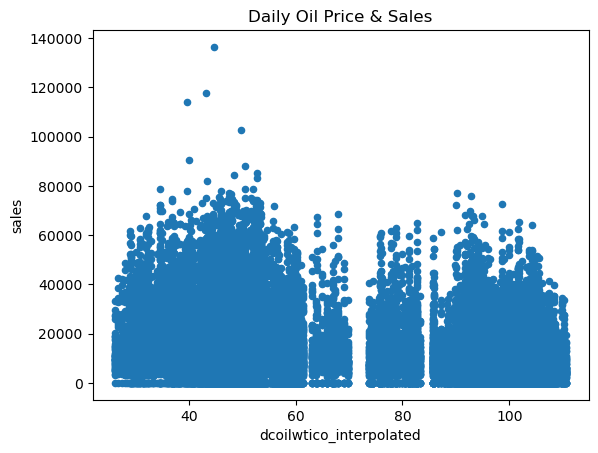

In [268]:
fig, ax = plt.subplots()
temp.plot.scatter(x="dcoilwtico_interpolated", y="sales", ax=ax, title="Daily Oil Price & Sales")
plt.show()

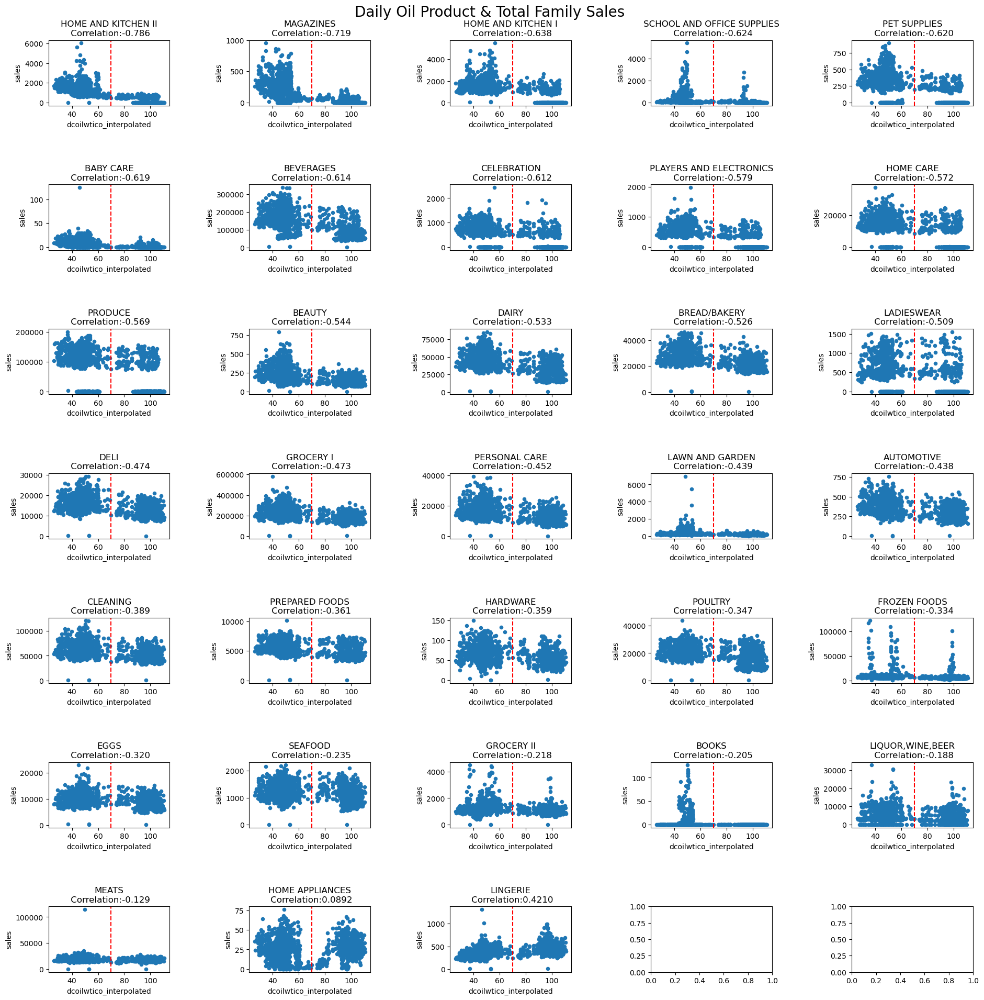

In [269]:
def plot_sales_and_oil_dependency():
    a = pd.merge(train.groupby(["date", "family"]).sales.sum().reset_index(), oil.drop("dcoilwtico", axis=1), how="left")
    c = a.groupby("family").corr("spearman").reset_index()
    c = c[c.level_1 == "dcoilwtico_interpolated"][["family", "sales"]].sort_values("sales")
    
    fig, axes = plt.subplots(7, 5, figsize=(20, 20))
    for i, fam in enumerate(c.family):
        a[a.family == fam].plot.scatter(x="dcoilwtico_interpolated", y="sales", ax=axes[i // 5, i % 5])
        axes[i // 5, i % 5].set_title(fam + "\n Correlation:" + str(c[c.family == fam].sales.iloc[0])[:6], fontsize=12)
        axes[i // 5, i % 5].axvline(x=70, color='r', linestyle='--')

    plt.tight_layout(pad=5)
    plt.suptitle("Daily Oil Product & Total Family Sales \n", fontsize=20)
    plt.show()

plot_sales_and_oil_dependency()

- rolling 평균 및 지연 추가, pacf 그래프를 통해서 lag = 1 값 정도가 의미 있다고 판단한다.

In [270]:
oil_rdy['rolling_mean_7'] = oil_rdy['dcoilwtico_interpolated'].rolling(7).mean()
oil_rdy.fillna(93.1, inplace=True)
oil_rdy

,dcoilwtico_interpolated,rolling_mean_7
date,,
2013-01-01,93.100000,93.100000
2013-01-02,93.140000,93.100000
2013-01-03,92.970000,93.100000
2013-01-04,93.120000,93.100000
2013-01-05,93.146667,93.100000
...,...,...
2017-08-27,46.816667,47.490000
2017-08-28,46.400000,47.348571
2017-08-29,46.460000,47.178571


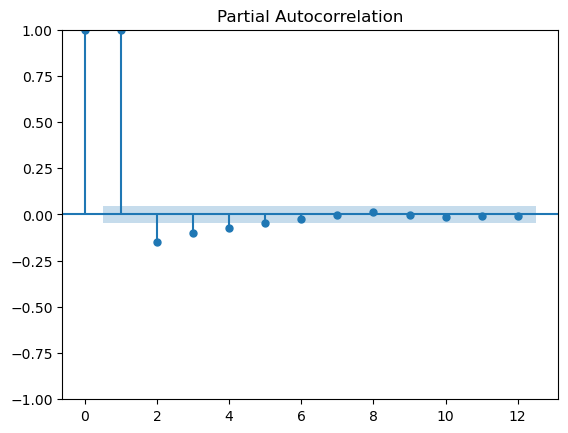

In [271]:
plot_pacf(oil_rdy.rolling_mean_7, lags=12, method='ywm');

In [272]:
for i in range(1, 2) :
    oil_rdy[f'oil_lag_{i}'] = oil_rdy.rolling_mean_7.shift(i)
oil_rdy.fillna(93.1, inplace=True)

In [273]:
stores = pd.read_csv(PATH + 'stores.csv', index_col='store_nbr', converters={'city': strip_spaces, 'state': strip_spaces})

# Let's look at the unique labels
print('Cities:\n', stores['city'].unique())  
print('States:\n', stores['state'].unique())  
print('Store types:\n', stores['type'].unique())
print('Clusters:\n', sorted(list(stores['cluster'].unique())))

# Do not forget about missing values
print('Missing values:', stores.isna().sum().sum())

Cities:
 ['Quito' 'SantoDomingo' 'Cayambe' 'Latacunga' 'Riobamba' 'Ibarra'
 'Guaranda' 'Puyo' 'Ambato' 'Guayaquil' 'Salinas' 'Daule' 'Babahoyo'
 'Quevedo' 'Playas' 'Libertad' 'Cuenca' 'Loja' 'Machala' 'Esmeraldas'
 'Manta' 'ElCarmen']
States:
 ['Pichincha' 'SantoDomingodelosTsachilas' 'Cotopaxi' 'Chimborazo'
 'Imbabura' 'Bolivar' 'Pastaza' 'Tungurahua' 'Guayas' 'SantaElena'
 'LosRios' 'Azuay' 'Loja' 'ElOro' 'Esmeraldas' 'Manabi']
Store types:
 ['D' 'B' 'C' 'E' 'A']
Clusters:
 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]
Missing values: 0


- stores 의 지역과 holidays 의 지역을 서로 연결하려고 한다.

In [274]:
stores_rdy = stores.loc[:, ['city', 'state']]
stores_rdy

,city,state
store_nbr,,
1,Quito,Pichincha
2,Quito,Pichincha
3,Quito,Pichincha
4,Quito,Pichincha
5,SantoDomingo,SantoDomingodelosTsachilas
6,Quito,Pichincha
7,Quito,Pichincha
8,Quito,Pichincha
9,Quito,Pichincha


## 2. Preprocessing
- 각 상점별, 제품별로 데이터 전처리를 한다.

In [275]:
train['date'] = train['date'].dt.to_period('D')
train_rdy = train.set_index(['store_nbr', 'family', 'date']).sort_index()
display(train_rdy)

test['date'] = test['date'].dt.to_period('D')
test_rdy = test.set_index(['store_nbr', 'family', 'date']).sort_index()
display(test_rdy)

sales  onpromotion
store_nbr family     date                              
1         AUTOMOTIVE 2013-01-01   0.000000            0
                     2013-01-02   2.000000            0
                     2013-01-03   3.000000            0
                     2013-01-04   3.000000            0
                     2013-01-05   5.000000            0
...                                    ...          ...
9         SEAFOOD    2017-08-11  23.831000            0
                     2017-08-12  16.859001            4
                     2017-08-13  20.000000            0
                     2017-08-14  17.000000            0
                     2017-08-15  16.000000            0

[2780316 rows x 2 columns]

onpromotion
store_nbr family     date                   
1         AUTOMOTIVE 2017-08-16            0
                     2017-08-17            0
                     2017-08-18            0
                     2017-08-19            0
                     2017-08-20            0
...                                      ...
9         SEAFOOD    2017-08-27            0
                     2017-08-28            0
                     2017-08-29            0
                     2017-08-30            0
                     2017-08-31            0

[28512 rows x 1 columns]

In [276]:
sdate = '2017-03-25' # start and end of training date
edate = '2017-08-15'

y_arr = []
onpromotion_arr = []
test_onpromotion_arr = []

for nbr in stores.index:
    # y_arr
    temp = train_rdy.loc[str(nbr), 'sales']
    y_arr.append(temp.unstack(['family']).loc[sdate:edate])
    
    # onpromotion_arr
    onpromotion = train_rdy.loc[str(nbr), 'onpromotion']
    onpromotion = onpromotion.unstack(['family']).loc[sdate:edate].sum(axis=1)
    onpromotion.name = 'onpromotion'
    onpromotion_arr.append(onpromotion)
    
    # test_onpromotion_arr
    test_onpromotion = test_rdy.loc[str(nbr), 'onpromotion']
    test_onpromotion = test_onpromotion.unstack(['family']).sum(axis=1)
    test_onpromotion.name = 'onpromotion'
    test_onpromotion_arr.append(test_onpromotion)
    
    # sum of all products that are on promotion in the currect store
    
y_arr[0]

family,AUTOMOTIVE,BABY CARE,BEAUTY,BEVERAGES,BOOKS,BREAD/BAKERY,CELEBRATION,CLEANING,DAIRY,DELI,...,MAGAZINES,MEATS,PERSONAL CARE,PET SUPPLIES,PLAYERS AND ELECTRONICS,POULTRY,PREPARED FOODS,PRODUCE,SCHOOL AND OFFICE SUPPLIES,SEAFOOD
date,,,,,,,,,,,,,,,,,,,,,
2017-03-25,5.0,0.0,4.0,2356.0,0.0,465.90300,25.0,690.0,943.0,149.002,...,8.0,274.62200,172.0,8.0,15.0,279.871,99.003000,2564.3850,0.0,37.283
2017-03-26,5.0,0.0,0.0,1110.0,0.0,216.93400,2.0,275.0,399.0,63.731,...,7.0,97.51200,84.0,6.0,3.0,157.796,23.000000,1192.8619,1.0,16.902
2017-03-27,6.0,0.0,0.0,2388.0,1.0,447.83700,12.0,668.0,855.0,147.980,...,6.0,306.90900,153.0,4.0,13.0,311.058,110.274000,2815.8760,0.0,33.669
2017-03-28,4.0,0.0,1.0,2184.0,0.0,416.42500,20.0,674.0,805.0,163.049,...,4.0,318.93298,147.0,7.0,7.0,293.925,97.750000,2009.6170,2.0,21.657
2017-03-29,2.0,0.0,3.0,2450.0,1.0,464.37700,15.0,818.0,956.0,139.192,...,18.0,299.49800,183.0,4.0,5.0,377.497,149.328000,4538.9850,0.0,34.074
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-08-11,1.0,0.0,1.0,1006.0,0.0,145.60700,4.0,341.0,343.0,64.302,...,4.0,385.99402,53.0,5.0,3.0,259.118,24.963001,1115.3340,0.0,19.424
2017-08-12,6.0,0.0,3.0,1659.0,0.0,243.22000,3.0,351.0,526.0,99.488,...,6.0,211.75600,227.0,3.0,6.0,217.664,48.058000,1762.4930,0.0,20.150
2017-08-13,1.0,0.0,1.0,803.0,0.0,136.67900,1.0,169.0,266.0,47.770,...,4.0,88.18200,45.0,2.0,0.0,115.758,20.346000,986.6690,0.0,11.378


In [277]:
fourier = CalendarFourier(freq='W', order=4)
X_arr = []
X_test_arr = []
store_index = 1

for y, onpromotion, test_onpromotion in zip(y_arr, onpromotion_arr, test_onpromotion_arr): 
    dp = DeterministicProcess(index=y.index,
                              constant=False,
                              order=1,
                              seasonal=False,
                              additional_terms=[fourier],
                              drop=True)
    X = dp.in_sample()
    X_test = dp.out_of_sample(steps=16)
    
    # On promotion
    X = X.merge(onpromotion, how='left', left_index=True, right_index=True)
    X_test = X_test.merge(test_onpromotion, how='left', left_index=True, right_index=True)
    
    # Holidays
    X = X.merge(holidays_rdy, how='left', left_index=True, right_index=True)
    X_test = X_test.merge(holidays_rdy, how='left', left_index=True, right_index=True)
    
    store_state = stores.loc[store_index, 'state']
    store_city = stores.loc[store_index, 'city']
    
    # Apply local holidays
    for j in X.index: 
        if X.loc[j, 'locale_name'].find(store_state) != -1 or X.loc[j, 'locale_name'].find(store_city) != -1:
            X.loc[j, 'work_day'] = False
    
    for j in X_test.index: 
        if X_test.loc[j, 'locale_name'].find(store_state) != -1 or X_test.loc[j, 'locale_name'].find(store_city) != -1:
            X_test.loc[j, 'work_day'] = False
    
    X.drop(['locale_name'], axis=1, inplace=True)  
    X_test.drop(['locale_name'], axis=1, inplace=True)  
    
    # Oil
    X = X.merge(oil_rdy, how='left', left_index=True, right_index=True)
    X_test = X_test.merge(oil_rdy, how='left', left_index=True, right_index=True)
    
    X_arr.append(X)
    X_test_arr.append(X_test)
    
    store_index += 1
    
X_arr[0]


,trend,"sin(1,freq=W-SUN)","cos(1,freq=W-SUN)","sin(2,freq=W-SUN)","cos(2,freq=W-SUN)","sin(3,freq=W-SUN)","cos(3,freq=W-SUN)",onpromotion,work_day,Earthquake,...,day_of_week_1,day_of_week_2,day_of_week_3,day_of_week_4,day_of_week_5,day_of_week_6,day_of_week_7,dcoilwtico_interpolated,rolling_mean_7,oil_lag_1
date,,,,,,,,,,,,,,,,,,,,,
2017-03-25,1.0,-0.974928,-0.222521,0.433884,-0.900969,0.781831,0.623490,114,False,0,...,0,0,0,0,0,1,0,47.206667,47.368571,47.504286
2017-03-26,2.0,-0.781831,0.623490,-0.974928,-0.222521,-0.433884,-0.900969,81,False,0,...,0,0,0,0,0,0,1,47.113333,47.245714,47.368571
2017-03-27,3.0,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,113,True,0,...,1,0,0,0,0,0,0,47.020000,47.135714,47.245714
2017-03-28,4.0,0.781831,0.623490,0.974928,-0.222521,0.433884,-0.900969,107,True,0,...,0,1,0,0,0,0,0,48.360000,47.327143,47.135714
2017-03-29,5.0,0.974928,-0.222521,-0.433884,-0.900969,-0.781831,0.623490,342,True,0,...,0,0,1,0,0,0,0,49.470000,47.638571,47.327143
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-08-11,140.0,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521,216,False,0,...,0,0,0,0,1,0,0,48.810000,49.188571,49.297143
2017-08-12,141.0,-0.974928,-0.222521,0.433884,-0.900969,0.781831,0.623490,103,False,0,...,0,0,0,0,0,1,0,48.403333,49.031429,49.188571
2017-08-13,142.0,-0.781831,0.623490,-0.974928,-0.222521,-0.433884,-0.900969,73,False,0,...,0,0,0,0,0,0,1,47.996667,48.825714,49.031429


In [278]:
X_test_arr[0]

,trend,"sin(1,freq=W-SUN)","cos(1,freq=W-SUN)","sin(2,freq=W-SUN)","cos(2,freq=W-SUN)","sin(3,freq=W-SUN)","cos(3,freq=W-SUN)",onpromotion,work_day,Earthquake,...,day_of_week_1,day_of_week_2,day_of_week_3,day_of_week_4,day_of_week_5,day_of_week_6,day_of_week_7,dcoilwtico_interpolated,rolling_mean_7,oil_lag_1
2017-08-16,145.0,0.974928,-0.222521,-0.433884,-0.900969,-0.781831,0.623490,524,True,0,...,0,0,1,0,0,0,0,46.800000,47.958571,48.357143
2017-08-17,146.0,0.433884,-0.900969,-0.781831,0.623490,0.974928,-0.222521,113,True,0,...,0,0,0,1,0,0,0,47.070000,47.748571,47.958571
2017-08-18,147.0,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521,278,True,0,...,0,0,0,0,1,0,0,48.590000,47.717143,47.748571
2017-08-19,148.0,-0.974928,-0.222521,0.433884,-0.900969,0.781831,0.623490,121,False,0,...,0,0,0,0,0,1,0,48.190000,47.686667,47.717143
2017-08-20,149.0,-0.781831,0.623490,-0.974928,-0.222521,-0.433884,-0.900969,88,False,0,...,0,0,0,0,0,0,1,47.790000,47.657143,47.686667
2017-08-21,150.0,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,118,True,0,...,1,0,0,0,0,0,0,47.390000,47.628571,47.657143
2017-08-22,151.0,0.781831,0.623490,0.974928,-0.222521,0.433884,-0.900969,103,True,0,...,0,1,0,0,0,0,0,47.650000,47.640000,47.628571
2017-08-23,152.0,0.974928,-0.222521,-0.433884,-0.900969,-0.781831,0.623490,364,True,0,...,0,0,1,0,0,0,0,48.450000,47.875714,47.640000
2017-08-24,153.0,0.433884,-0.900969,-0.781831,0.623490,0.974928,-0.222521,130,True,0,...,0,0,0,1,0,0,0,47.240000,47.900000,47.875714
2017-08-25,154.0,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521,294,True,0,...,0,0,0,0,1,0,0,47.650000,47.765714,47.900000


## 3. Modelling
- Ridge Regressor
    + 선형 회귀의 일종으로, L2 규제를 사용하여 과적합을 방지하는 모델입니다. 선형 회귀 모델에서는 학습 데이터에 가장 적합한 직선을 찾기 위해 최소제곱법을 사용합니다. 이 때, 예측 변수들이 서로 상관관계가 있거나 변수의 수가 많아지면 최소제곱법을 사용하면서 overfitting 문제가 발생할 수 있습니다.
    + Ridge regression은 이러한 문제를 해결하기 위해, 모델의 가중치(w)들을 최소화하면서 동시에 w의 크기를 제한합니다. 이를 위해 L2 규제를 사용합니다. L2 규제는 가중치의 제곱합을 최소화하는 방법으로, 모델의 일반화 성능을 향상시키는 역할을 합니다.

- 참조 : https://zephyrus1111.tistory.com/72

In [279]:
# RidgeRegressor
ridge = make_pipeline(RobustScaler(), Ridge(alpha=31.0))

t_errors = []
v_errors = []

train_preds = []
val_preds = []

# Collect errors for each store
for X, y in zip(X_arr, y_arr):
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, random_state=1, shuffle=False)

    model = ridge.fit(X_train, y_train)
    
    train_pred = pd.DataFrame(model.predict(X_train), index=X_train.index, columns=y_train.columns).clip(0.0)
    val_pred = pd.DataFrame(model.predict(X_val), index=X_val.index, columns=y_val.columns).clip(0.0)

    train_preds.append(train_pred)
    val_preds.append(val_pred)

    y_train = y_train.stack(['family']).reset_index()
    y_train['pred'] = train_pred.stack(['family']).reset_index().loc[:, 0]
    
    y_val = y_val.stack(['family']).reset_index()
    y_val['pred'] = val_pred.stack(['family']).reset_index().loc[:, 0]

    
    t_errors.append(y_train.groupby('family').apply(lambda r: np.sqrt(mean_squared_log_error(r.loc[:, 0], r['pred']))))
    v_errors.append(y_val.groupby('family').apply(lambda r: np.sqrt(mean_squared_log_error(r.loc[:, 0], r['pred'])))) 

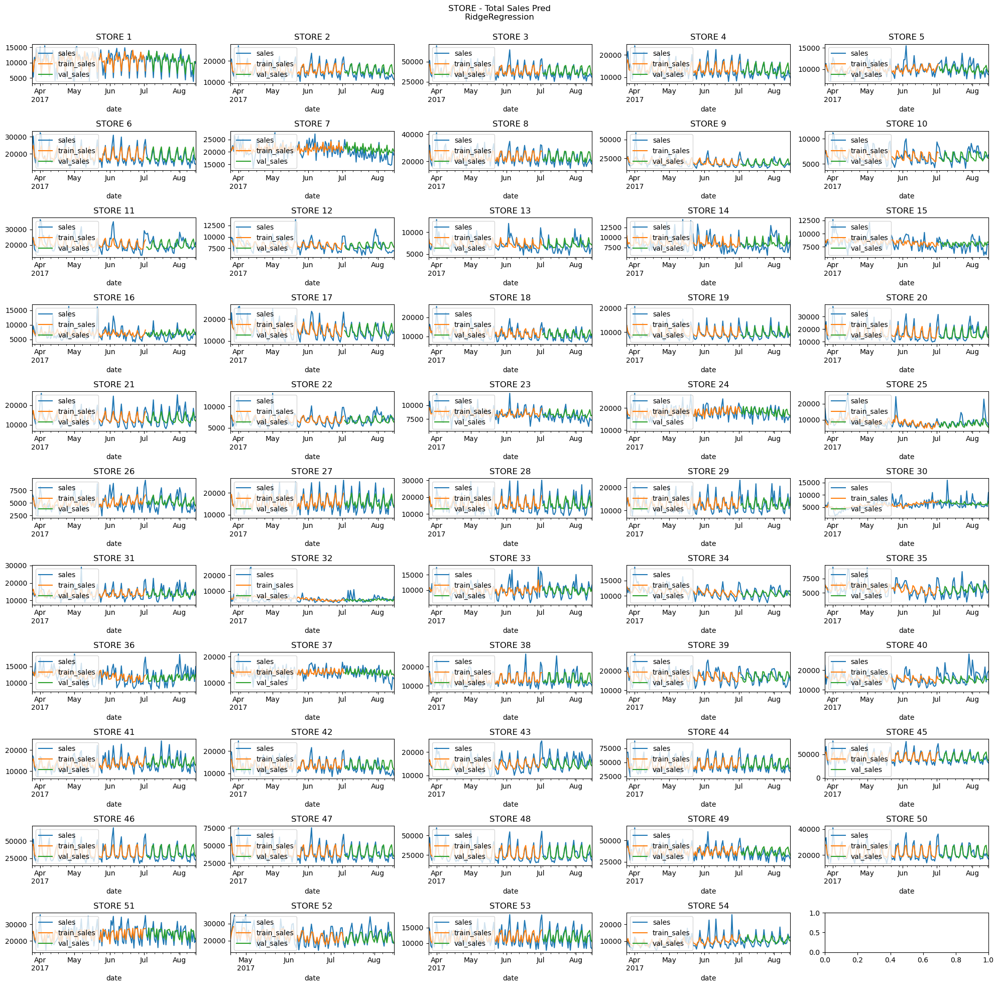

In [280]:
fig, ax = plt.subplots(11, 5, figsize=(20, 20))
j = 0; k = 0
for i, y in enumerate(y_arr):
    (y_arr[i]).sum(axis=1).plot(ax=ax[j, k], label="sales")
    (train_preds[i]).sum(axis=1).plot(ax=ax[j, k], label="train_sales")
    (val_preds[i]).sum(axis=1).plot(ax=ax[j, k], label="val_sales")
    ax[j, k].set_title(f"STORE {i+1}")
    ax[j, k].legend(loc=2)
    k += 1
    if k > 4:
        k = 0
        j += 1
plt.suptitle("STORE - Total Sales Pred\nRidgeRegression\n\n", fontsize=12)
plt.tight_layout()
plt.show()

In [281]:
y_arr[0]

family,AUTOMOTIVE,BABY CARE,BEAUTY,BEVERAGES,BOOKS,BREAD/BAKERY,CELEBRATION,CLEANING,DAIRY,DELI,...,MAGAZINES,MEATS,PERSONAL CARE,PET SUPPLIES,PLAYERS AND ELECTRONICS,POULTRY,PREPARED FOODS,PRODUCE,SCHOOL AND OFFICE SUPPLIES,SEAFOOD
date,,,,,,,,,,,,,,,,,,,,,
2017-03-25,5.0,0.0,4.0,2356.0,0.0,465.90300,25.0,690.0,943.0,149.002,...,8.0,274.62200,172.0,8.0,15.0,279.871,99.003000,2564.3850,0.0,37.283
2017-03-26,5.0,0.0,0.0,1110.0,0.0,216.93400,2.0,275.0,399.0,63.731,...,7.0,97.51200,84.0,6.0,3.0,157.796,23.000000,1192.8619,1.0,16.902
2017-03-27,6.0,0.0,0.0,2388.0,1.0,447.83700,12.0,668.0,855.0,147.980,...,6.0,306.90900,153.0,4.0,13.0,311.058,110.274000,2815.8760,0.0,33.669
2017-03-28,4.0,0.0,1.0,2184.0,0.0,416.42500,20.0,674.0,805.0,163.049,...,4.0,318.93298,147.0,7.0,7.0,293.925,97.750000,2009.6170,2.0,21.657
2017-03-29,2.0,0.0,3.0,2450.0,1.0,464.37700,15.0,818.0,956.0,139.192,...,18.0,299.49800,183.0,4.0,5.0,377.497,149.328000,4538.9850,0.0,34.074
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-08-11,1.0,0.0,1.0,1006.0,0.0,145.60700,4.0,341.0,343.0,64.302,...,4.0,385.99402,53.0,5.0,3.0,259.118,24.963001,1115.3340,0.0,19.424
2017-08-12,6.0,0.0,3.0,1659.0,0.0,243.22000,3.0,351.0,526.0,99.488,...,6.0,211.75600,227.0,3.0,6.0,217.664,48.058000,1762.4930,0.0,20.150
2017-08-13,1.0,0.0,1.0,803.0,0.0,136.67900,1.0,169.0,266.0,47.770,...,4.0,88.18200,45.0,2.0,0.0,115.758,20.346000,986.6690,0.0,11.378


In [282]:
y_arr[0].add(y_arr[51], fill_value=0)

family,AUTOMOTIVE,BABY CARE,BEAUTY,BEVERAGES,BOOKS,BREAD/BAKERY,CELEBRATION,CLEANING,DAIRY,DELI,...,MAGAZINES,MEATS,PERSONAL CARE,PET SUPPLIES,PLAYERS AND ELECTRONICS,POULTRY,PREPARED FOODS,PRODUCE,SCHOOL AND OFFICE SUPPLIES,SEAFOOD
date,,,,,,,,,,,,,,,,,,,,,
2017-03-25,5.0,0.0,4.0,2356.0,0.0,465.90300,25.0,690.0,943.0,149.002,...,8.0,274.62200,172.0,8.0,15.0,279.871,99.003000,2564.3850,0.0,37.283
2017-03-26,5.0,0.0,0.0,1110.0,0.0,216.93400,2.0,275.0,399.0,63.731,...,7.0,97.51200,84.0,6.0,3.0,157.796,23.000000,1192.8619,1.0,16.902
2017-03-27,6.0,0.0,0.0,2388.0,1.0,447.83700,12.0,668.0,855.0,147.980,...,6.0,306.90900,153.0,4.0,13.0,311.058,110.274000,2815.8760,0.0,33.669
2017-03-28,4.0,0.0,1.0,2184.0,0.0,416.42500,20.0,674.0,805.0,163.049,...,4.0,318.93298,147.0,7.0,7.0,293.925,97.750000,2009.6170,2.0,21.657
2017-03-29,2.0,0.0,3.0,2450.0,1.0,464.37700,15.0,818.0,956.0,139.192,...,18.0,299.49800,183.0,4.0,5.0,377.497,149.328000,4538.9850,0.0,34.074
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-08-11,18.0,0.0,14.0,6650.0,0.0,1359.12800,29.0,2281.0,1860.0,561.381,...,23.0,1377.93602,598.0,44.0,37.0,1034.641,216.710001,7278.5630,4.0,42.424
2017-08-12,19.0,0.0,11.0,6047.0,0.0,1157.70900,25.0,1743.0,1675.0,480.625,...,16.0,668.14500,607.0,20.0,37.0,712.719,137.443000,6012.8490,2.0,25.150
2017-08-13,22.0,0.0,13.0,5719.0,0.0,1208.66600,16.0,1735.0,1666.0,483.512,...,18.0,575.46700,428.0,14.0,32.0,709.052,162.914000,5559.7360,15.0,23.378


In [283]:
fam_y = 0
fam_train_pred = 0
fam_val_pred = 0

for i, y in enumerate(y_arr):
    if i == 0:
        fam_y = y_arr[i]
        fam_train_pred = train_preds[i]
        fam_val_pred = val_preds[i]
    else:
        fam_y = fam_y.add(y_arr[i], fill_value=0).fillna(0)
        fam_train_pred = fam_train_pred.add(train_preds[i], fill_value=0).fillna(0)
        fam_val_pred = fam_val_pred.add(val_preds[i], fill_value=0).fillna(0)

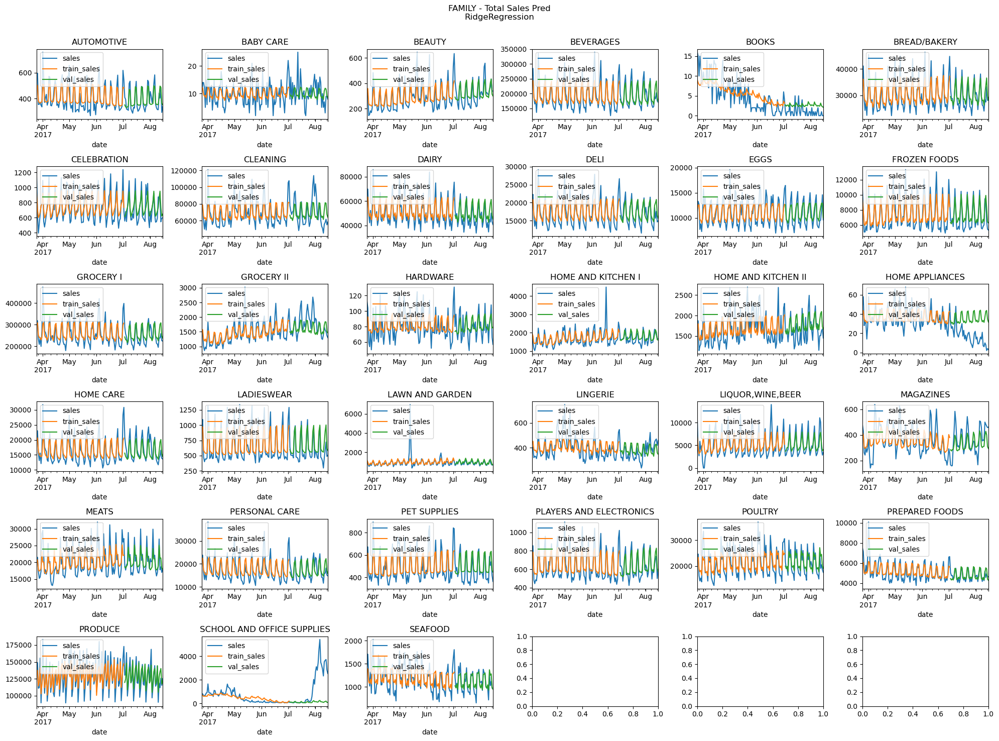

In [284]:
fig, ax = plt.subplots(6, 6, figsize=(20, 15))
j = 0; k = 0
for i, key in enumerate(fam_y.keys()):
    fam_y[key].plot(ax=ax[j, k], label="sales")
    fam_train_pred[fam_train_pred.index < "2017-07-03"][key].plot(ax=ax[j, k], label="train_sales")
    fam_val_pred[key].plot(ax=ax[j, k], label="val_sales")
    ax[j, k].set_title(f"{key}")
    ax[j, k].legend(loc=2)
    k += 1
    if k > 5:
        k = 0
        j += 1
plt.suptitle("FAMILY - Total Sales Pred\nRidgeRegression\n\n", fontsize=12)
plt.tight_layout()
plt.show()

In [285]:
# 총 Train 데이터에 대해서 Validation 데이터의 RMSLE 합계
sum(v_errors).sort_values(ascending=False)

family
SCHOOL AND OFFICE SUPPLIES    59.735033
LINGERIE                      36.326275
GROCERY II                    32.111223
CELEBRATION                   30.549612
HARDWARE                      29.545638
BEAUTY                        28.961956
LIQUOR,WINE,BEER              28.723135
AUTOMOTIVE                    28.310008
MAGAZINES                     27.647258
HOME AND KITCHEN I            26.817769
LADIESWEAR                    26.777758
SEAFOOD                       26.518895
PET SUPPLIES                  26.197227
HOME AND KITCHEN II           25.851510
PLAYERS AND ELECTRONICS       25.195873
HOME APPLIANCES               24.553918
LAWN AND GARDEN               19.360658
EGGS                          16.310194
FROZEN FOODS                  16.008732
CLEANING                      15.695489
PREPARED FOODS                14.463213
PERSONAL CARE                 13.135347
BABY CARE                     12.080686
HOME CARE                     11.980725
BEVERAGES                     11.

In [286]:
(sum(v_errors)/len(v_errors)).mean()

0.38648557309233744

#### LinearRegression 모델 비교

In [287]:
# LinearRegression
linear = make_pipeline(RobustScaler(), LinearRegression())

t_errors = []
v_errors = []

train_preds = []
val_preds = []

# Collect errors for each store
for X, y in zip(X_arr, y_arr):
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, random_state=1, shuffle=False)

    model = linear.fit(X_train, y_train)
    
    train_pred = pd.DataFrame(model.predict(X_train), index=X_train.index, columns=y_train.columns).clip(0.0)
    val_pred = pd.DataFrame(model.predict(X_val), index=X_val.index, columns=y_val.columns).clip(0.0)

    train_preds.append(train_pred)
    val_preds.append(val_pred)

    y_train = y_train.stack(['family']).reset_index()
    y_train['pred'] = train_pred.stack(['family']).reset_index().loc[:, 0]

    y_val = y_val.stack(['family']).reset_index()
    y_val['pred'] = val_pred.stack(['family']).reset_index().loc[:, 0]

    t_errors.append(y_train.groupby('family').apply(lambda r: np.sqrt(mean_squared_log_error(r.loc[:, 0], r['pred']))))
    v_errors.append(y_val.groupby('family').apply(lambda r: np.sqrt(mean_squared_log_error(r.loc[:, 0], r['pred'])))) 

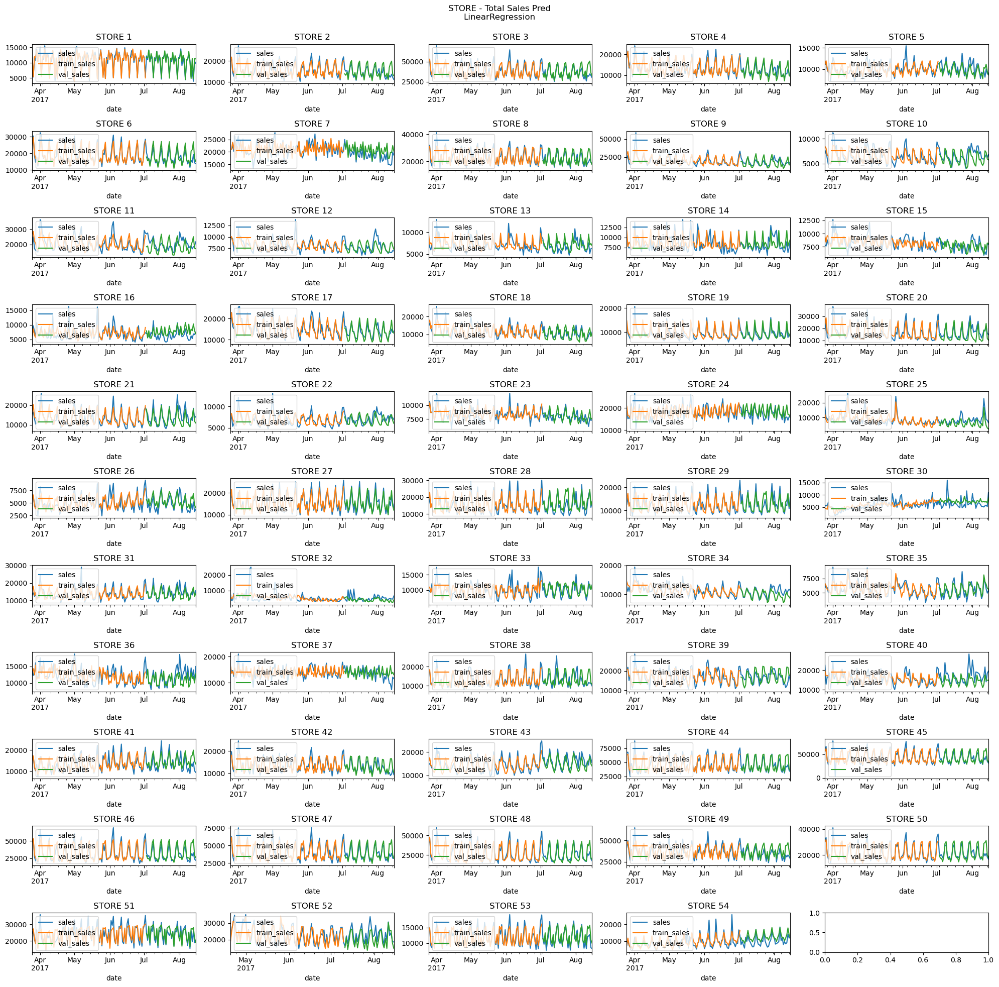

In [288]:
fig, ax = plt.subplots(11, 5, figsize=(20, 20))
j = 0; k = 0
for i, y in enumerate(y_arr):
    (y_arr[i]).sum(axis=1).plot(ax=ax[j, k], label="sales")
    (train_preds[i]).sum(axis=1).plot(ax=ax[j, k], label="train_sales")
    (val_preds[i]).sum(axis=1).plot(ax=ax[j, k], label="val_sales")
    ax[j, k].set_title(f"STORE {i+1}")
    ax[j, k].legend(loc=2)
    k += 1
    if k > 4:
        k = 0
        j += 1
plt.suptitle("STORE - Total Sales Pred\nLinearRegression\n\n", fontsize=12)
plt.tight_layout()
plt.show()

In [289]:
fam_y = 0
fam_train_pred = 0
fam_val_pred = 0

for i, y in enumerate(y_arr):
    if i == 0:
        fam_y = y_arr[i]
        fam_train_pred = train_preds[i]
        fam_val_pred = val_preds[i]
    else:
        fam_y = fam_y.add(y_arr[i], fill_value=0).fillna(0)
        fam_train_pred = fam_train_pred.add(train_preds[i], fill_value=0).fillna(0)
        fam_val_pred = fam_val_pred.add(val_preds[i], fill_value=0).fillna(0)

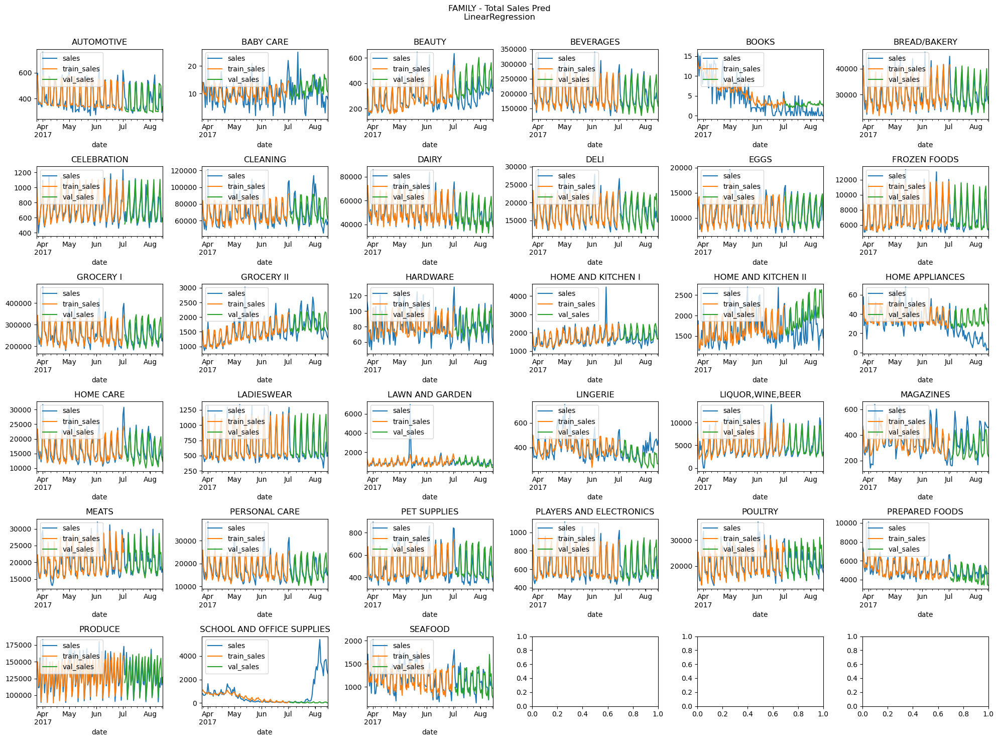

In [290]:
fig, ax = plt.subplots(6, 6, figsize=(20, 15))
j = 0; k = 0
for i, key in enumerate(fam_y.keys()):
    fam_y[key].plot(ax=ax[j, k], label="sales")
    fam_train_pred[fam_train_pred.index < "2017-07-03"][key].plot(ax=ax[j, k], label="train_sales")
    fam_val_pred[key].plot(ax=ax[j, k], label="val_sales")
    ax[j, k].set_title(f"{key}")
    ax[j, k].legend(loc=2)
    k += 1
    if k > 5:
        k = 0
        j += 1
plt.suptitle("FAMILY - Total Sales Pred\nLinearRegression\n\n", fontsize=12)
plt.tight_layout()
plt.show()

In [291]:
# 총 Train 데이터에 대해서 Validation 데이터의 RMSLE 합계
sum(v_errors).sort_values(ascending=False)

family
SCHOOL AND OFFICE SUPPLIES    64.249622
LINGERIE                      44.513740
LIQUOR,WINE,BEER              39.125062
GROCERY II                    36.470363
BEAUTY                        35.537259
HOME AND KITCHEN I            34.578637
AUTOMOTIVE                    33.967928
CELEBRATION                   33.725325
HARDWARE                      32.163041
HOME AND KITCHEN II           31.768396
SEAFOOD                       31.407280
MAGAZINES                     30.770255
LADIESWEAR                    29.203710
PLAYERS AND ELECTRONICS       28.328406
LAWN AND GARDEN               28.195145
PET SUPPLIES                  27.419162
HOME APPLIANCES               25.583384
FROZEN FOODS                  19.955932
PREPARED FOODS                18.664433
CLEANING                      17.333295
EGGS                          16.522446
PERSONAL CARE                 15.196167
BEVERAGES                     14.884709
HOME CARE                     13.912143
BABY CARE                     13.

In [292]:
(sum(v_errors)/len(v_errors)).mean()

0.446710135378663